In [1]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import pandas as pd
import healpy as hp
import time
import warnings
import scipy.fftpack
import scipy.stats as stats


# functions

In [253]:
#Gabor filter

def gabor_2d(M, N, sigma, freq):
    """
        Computes a symmetric 2D Gabor filter.
        ----------
        M, N : int
            spatial sizes
        sigma : float
            bandwidth parameter
        freq : float
            central frequency (in [0, pi])
        theta : float
            angle in [0, pi]
        offset : int, optional
            offset by which the signal starts
        Returns
        -------
        gabor_2d : ndarray
            numpy array of size (M, N)
    """
    gab = np.zeros((M, N), np.complex64)
    [x, y] = np.mgrid[-1*(M//2):(M//2),-1*(N//2):(N//2)]
    #print ()
    arg = -(x**2+y**2)/(2*sigma*sigma) + 1.j * freq*np.sqrt(x**2+y**2)
    #print (arg.shape)
    gab += np.exp(arg)

    norm_factor = ( 2 * np.pi * sigma**2 )
    gab /= norm_factor

    return gab

In [254]:
def morlet_2d(M, N, sigma, freq):
    """
        Computes a symmetric 2D Morlet filter.
        A Morlet filter is the sum of a Gabor filter and a low-pass filter
        to ensure that the sum has exactly zero mean in the temporal domain.
        It is defined by the following formula in space:
        psi(u) = g_{sigma}(u) (e^(i xi^T u) - beta)
        where g_{sigma} is a Gaussian envelope, xi is a frequency and beta is
        the cancelling parameter.
        Parameters
        ----------
        M, N : int
            spatial sizes
        sigma : float
            bandwidth parameter
        xi : float
            central frequency (in [0, pi])
        theta : float
            angle in [0, pi]
        Returns
        -------
        morlet_2d : ndarray
            numpy array of size (M, N)
    """
    wv = gabor_2d(M, N, sigma,  freq)
    wv_modulus = gabor_2d(M, N, sigma, 0)
    K = np.sum(wv) / np.sum(wv_modulus)

    mor = wv - K * wv_modulus
    #norm = np.sum((np.abs(mor))**2)
    #mor = mor /np.sqrt(norm)
    #mor = mor / np.mean(np.abs(mor)) / (M*N)
    #mor /= np.mean(np.abs(mor)) * (M*N)
    #norm = 
    return mor

In [255]:
def comp_s1(image, morlet_arr, jmax, gaus_arr = None):
    
    s1_arr = np.zeros (jmax)
    i1_arr = []
    for j1 in range(jmax):
        
        #sigma1=0.8*2**j1
        #freq1=(3*np.pi)/(4.*2**j1)
        
        #mor1=morlet_2d(M, N, sigma1, freq1)
        #phi1=gabor_2d(M,N,sigma1,0)
        
        mor = morlet_arr[j1]
        mor_fft=np.fft.fft2(np.fft.fftshift(mor))
        
        #freqcol = np.fft.fftfreq(morlet_arr[j1].shape[1])
        #freqrow = np.fft.fftfreq(morlet_arr[j1].shape[0])
        #norm = np.sum (np.abs(mor_fft)**2 * freqcol[1]*freqrow[0])
        
        img_fft = np.fft.fft2(image)
        I1_fft = img_fft * mor_fft
        I1 = np.abs (np.fft.ifft2(I1_fft))
        
        
        if gaus_arr == None:
            S1 = I1
        else:
            phi = gaus_arr[j1]
            phi_fft = np.real(np.fft.fft2(np.fft.fftshift(phi)))
            U1_fft = np.fft.fft2(I1)
            S1_fft = U1*phi_fft
            S1 = np.real(np.fft.ifft2(S1_fft))
        
        i1_arr.append(S1)
        s1_arr[j1] = np.mean(S1)
    
    return s1_arr , i1_arr

In [256]:
def comp_s2 (i1_arr, morlet_arr, jmax, gaus_arr = None ):
    
    s2_arr = np.zeros ((jmax,jmax))
    i2_arr = []
    for j1 in range(jmax):
        i2_tmp = []
        i1 = i1_arr[j1]
        i1_fft = np.fft.fft2(i1)
        
        for j2 in range (jmax):
        
            mor = morlet_arr[j2]
            mor_fft=np.fft.fft2(np.fft.fftshift(mor))

            
            I2_fft = i1_fft * mor_fft
            I2 = np.abs (np.fft.ifft2(I2_fft))


            if gaus_arr == None:
                S2 = I2
            else:
                phi = gaus_arr[j2]
                phi_fft = np.real(np.fft.fft2(np.fft.fftshift(phi)))
                U2_fft = np.fft.fft2(I2)
                S2_fft = I2*phi_fft
                S2 = np.abs(np.fft.ifft2(S2_fft))

            s2_arr[j1,j2] = np.mean(S2)
            i2_tmp.append(S2)
        i2_arr.append (i2_tmp)
    return s2_arr , i2_arr

In [257]:
def comp_s3 (i2_arr, morlet_arr, jmax, gaus_arr = None ):
    
    s3_arr = np.zeros ((jmax,jmax,jmax))
    #i3_arr = []
    for j1 in range(jmax):
        for j2 in range (j1+1 ,jmax):
            #i3_tmp = []
            i2 = i2_arr[j1][j2]
            i2_fft = np.fft.fft2(i2)
        
            for j3 in range (jmax):
        
                mor = morlet_arr[j3]
                mor_fft=np.real(np.fft.fft2(np.fft.fftshift(mor)))


                I3_fft = i2_fft * mor_fft
                I3 = np.abs (np.fft.ifft2(I3_fft))


                if gaus_arr == None:
                    S3 = I3
                else:
                    phi = gaus_arr[j3]
                    phi_fft = np.real(np.fft.fft2(np.fft.fftshift(phi)))
                    U3_fft = np.fft.fft2(I3)
                    S3_fft = I3*phi_fft
                    S3 = np.abs(np.fft.ifft2(S3_fft))

                s3_arr[j1,j2,j3] = np.mean(S3)
                #i3_tmp.append(S2)
        #i2_arr.append (i2_tmp)
    return s3_arr #, i2_arr

In [258]:
def calculate_power (image):
    
    xnpix = image.shape[1]
    ynpix = image.shape[0]

    fourier_image = np.fft.fftn(image)
    fourier_amplitudes = np.abs(fourier_image)**2

    xkfreq = np.fft.fftfreq(xnpix) * xnpix
    #print(xkfreq)
    
    ykfreq = np.fft.fftfreq(ynpix) * ynpix
    kfreq2D = np.meshgrid(xkfreq, ykfreq)
    knrm = np.sqrt(kfreq2D[0]**2 + kfreq2D[1]**2)
    #print(knrm)
    knrm = knrm.flatten()
    #print(knrm)
    fourier_amplitudes = fourier_amplitudes.flatten()

    kbins = np.arange(0.5, min(xnpix, ynpix)//2+1, 1.)
    print (kbins)
    kvals = 0.5 * (kbins[1:] + kbins[:-1])
    Abins, _, _ = stats.binned_statistic(knrm, fourier_amplitudes,
                                         statistic = "mean",
                                         bins = kbins)
    Abins *= np.pi * (kbins[1:]**2 - kbins[:-1]**2)

    return kvals, Abins 


In [259]:
def fourier_power_spectrum(img_r, img_len, bin_k):
    """
    Compute the Fourier power spectrum given a 2-dimensional real-space map.
    
    Parameters
    ----------
        img_r: arraylike
            2-dimensional real-space map 
            
        img_len: float
            image size 
            (units define output units of wavenumber and power spectrum)
            
        bin_k: int
            number of bins in Fourier space
            
    Returns
    -------
        k: np.ndarray
            wavenumber in units of inverse [img_len]
            
        pk: np.ndarray
            power spectrum in units of [img_len]**2
    """
    assert np.ndim(img_r) == 2, 'img_r is not 2D'
    img_pix = np.size(img_r, axis=0)  # pixel number per axis
    img_dim = np.ndim(img_r)  # image dimension

    # This first 'paragraph' is to create masks of indices corresponding to 
    # one Fourier bin each.
    freq = np.fft.fftfreq(n=img_pix, d=img_len/img_pix) #* 2*np.pi
    rfreq = np.fft.rfftfreq(n=img_pix, d=img_len/img_pix) #* 2*np.pi
    kx, ky = np.meshgrid(freq, rfreq, indexing='ij')
    k_abs = np.sqrt(kx**2. + ky**2.)
    # The following complicated line is actually only creating a 1D array 
    # spanning k-space logarithmically from minimum k_abs to maximum. To 
    # start slightly below the minimum and finish slightly above the maximum 
    # I use ceil and floor. To ceil and floor not to the next integer but to 
    # the next 15th digit, I multiply by 1e15 before flooring and divide by 
    # the same amount afterwards. Since the ceiled/floored value is actually 
    # the exponent used for the logspace, going to the next integer would be 
    # too much, which is why I do this ceil/floor to digit procedure.
    k_log = np.logspace(np.floor(np.log10(np.min(k_abs[1:]))*1.e15)/1.e15, np.ceil(np.log10(np.max(k_abs[1:]))*1.e15)/1.e15, bin_k)

    img_k = np.fft.rfftn(np.fft.fftshift(img_r)) * (img_len/img_pix)**img_dim
    pk = np.empty(np.size(k_log)-1)
    for i in range(np.size(k_log)-1):
        mask = (k_abs >= k_log[i]) & (k_abs < k_log[i+1])
        pk[i] = np.mean(np.abs(img_k[mask])**2.) #/ img_len**img_dim

    k = (k_log[1:] + k_log[:-1]) / 2

    return k, pk

In [227]:
#loading the image
img = plt.imread ("/Users/arefe/Downloads/cat.jpg")[:,:,0]
img = img.astype('float')
#img = img[:512,:512]
#img = plt.imread ("/Users/arefe/Downloads/lizard.jpeg")
#img = img.astype('float')
#img = img[:128,:128]
#img /= np.sum (np.abs(img))
#img = plt.imread ("/Users/arefe/Downloads/lion.jpeg")[:,:,0]
#img = img.astype('float')
#img = plt.imread ("/Users/arefe/Downloads/elephant.jpg")
#img = img.astype('float')
#img = img[1:,]
#img = plt.imread ("/Users/arefe/Downloads/leaf.jpeg")[:,:,0]
#img = img.astype('float')
#img = plt.imread ("/Users/arefe/Downloads/sillitoe.gif")[1:,:,0]
#img = img.astype('float')

(800, 1200)

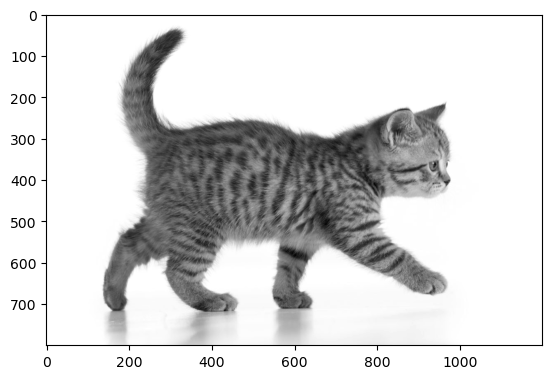

In [228]:
plt.imshow(img, cmap="gist_gray")
img.shape

In [229]:
# dimensions of the picture 
# x and y sizes should be even numbers 
x_dim = np.shape (img)[0]
y_dim = np.shape (img)[1]
# surface area of the image
mu0 = x_dim*y_dim
#normalizing the image
#img = img/mu0

In [230]:
#maximum scale of the picture is chosen so that 2**jmax < min (x_dim , y_dim)
jmax = int (np.floor(np.log (min(x_dim,y_dim))/np.log(2))+1)
print(jmax)

10


In [231]:
# making a list of morlet maps

morlet_arr = []
for j in range (jmax):
    sigma=0.8*2**j
    freq=(3*np.pi)/(4.*2**j)
    mor = morlet_2d (x_dim, y_dim, sigma, freq)
    #norm = np.sum((np.abs(mor))**2)
    #print (norm)
    #mor = mor/norm
    morlet_arr.append(mor)
    
    

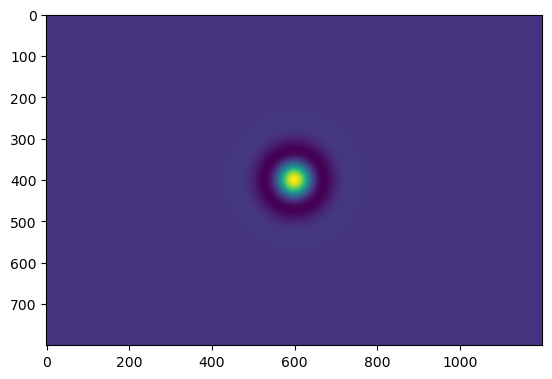

In [232]:
plt.imshow(np.real(morlet_arr[6]))

In [233]:
np.sum((np.abs(morlet_arr[4]/np.sqrt(0.00032574887)))**2)

655.3601

In [234]:
s0 = np.mean(img)

In [235]:
s1 , i1 = comp_s1(img, morlet_arr, jmax)

In [236]:
s2 , i2 = comp_s2(i1, morlet_arr, jmax)

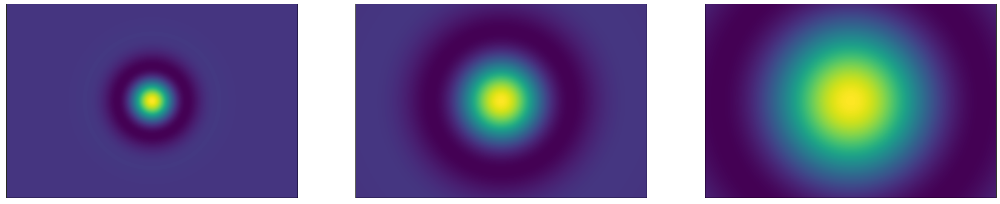

In [237]:
fig , ax = plt.subplots(1, 3, figsize = (30,20))
for i in range (7,jmax):
    ax[i-7].imshow(np.real(morlet_arr[i]), label='j='+str(i))
    ax[i-7].axes.xaxis.set_visible(False)
    ax[i-7].axes.yaxis.set_visible(False)
    #plt.legend(labelcolor='linecolor')
    legend = plt.legend
    #plt.setp(legend.get_texts(), color='w')
    
#plt.show()
#plt.legend(labelcolor = "white")
fig.savefig ("morlet_profile.pdf")

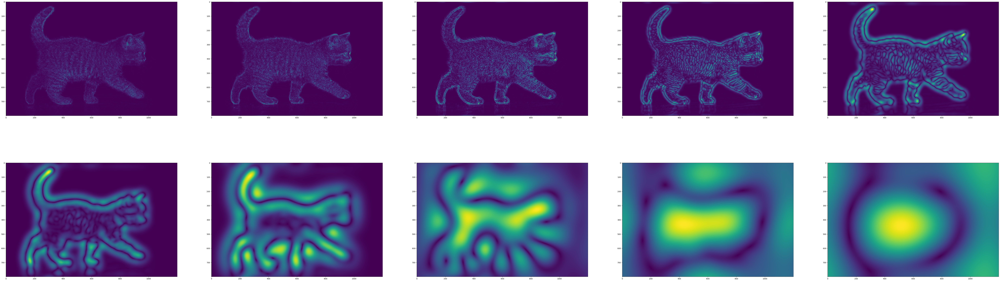

In [238]:
fig , ax = plt.subplots (2, 5 , figsize = (100,30))
for i in range (5):
    ax[0,i].imshow(i1[i])

for i in range (5,10):
    ax[1,i-5].imshow(i1[i])

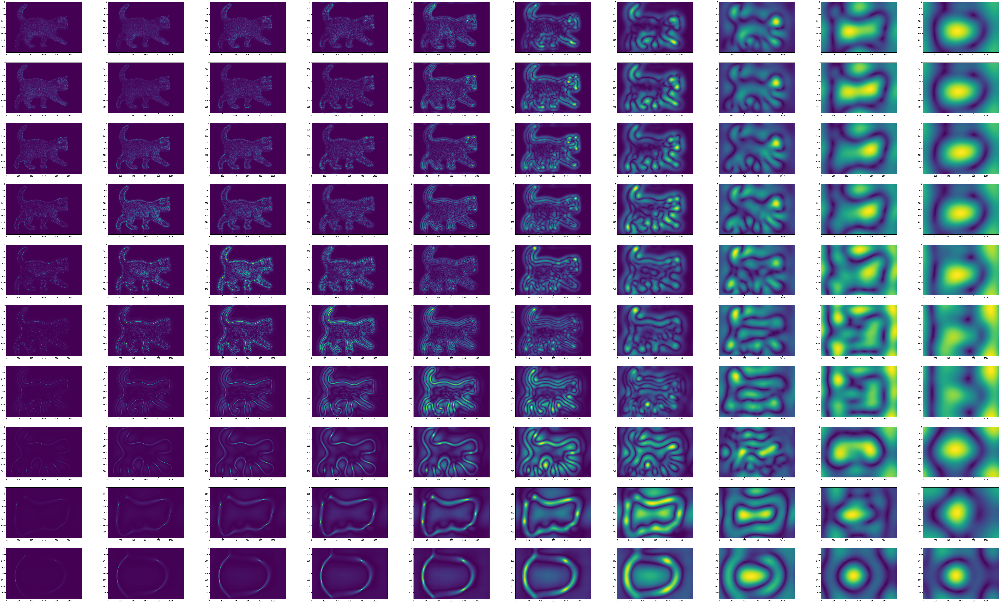

In [239]:
fig , ax = plt.subplots (jmax, jmax , figsize = (100,60))
for i in range (jmax):
    for j in range (jmax):
        ax[i,j].imshow(i2[i][j])


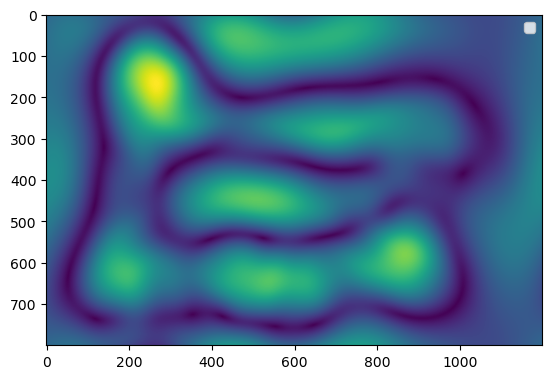

In [240]:
plt.imshow(i2[6][7])
plt.legend ("$I_1^{j_1}$" ,labelcolor = "white")

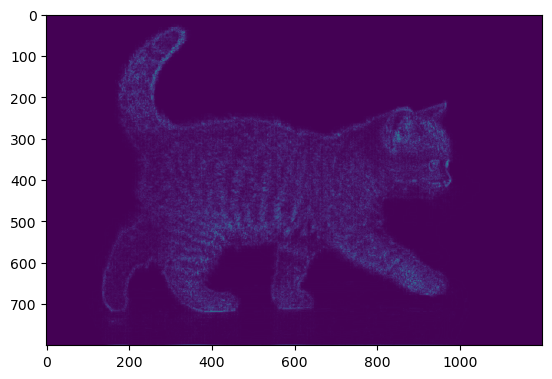

In [241]:
plt.imshow(i1[0])

In [242]:
jarray = np.arange (jmax)
scale = 2**jarray

Text(0, 0.5, 'S1')

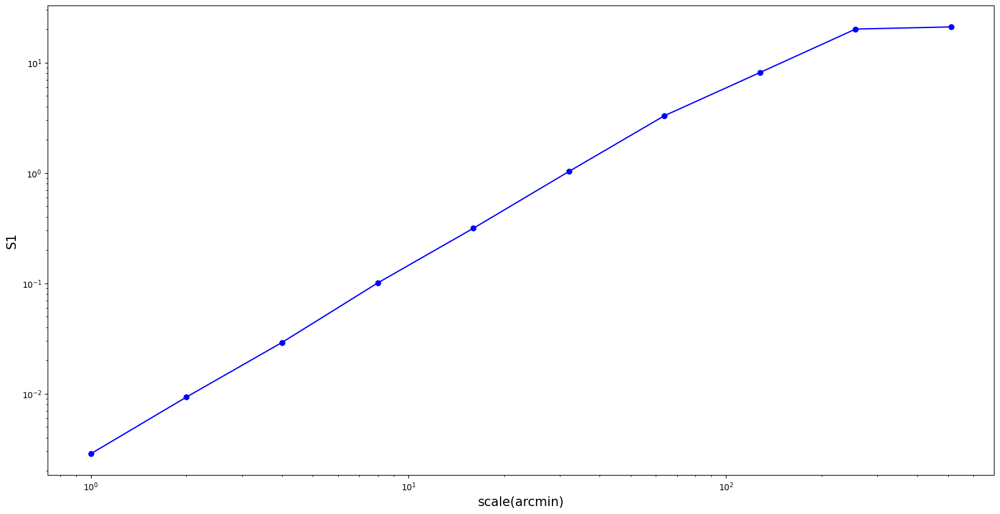

In [243]:
plt.figure(figsize=(20,10))
plt.loglog (scale,s1/s0,'o-',color="blue")

plt.xlabel("scale(arcmin)")
plt.ylabel("S1") 
#plt.legend (["non-Gaussian", "Gaussian"])

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that 

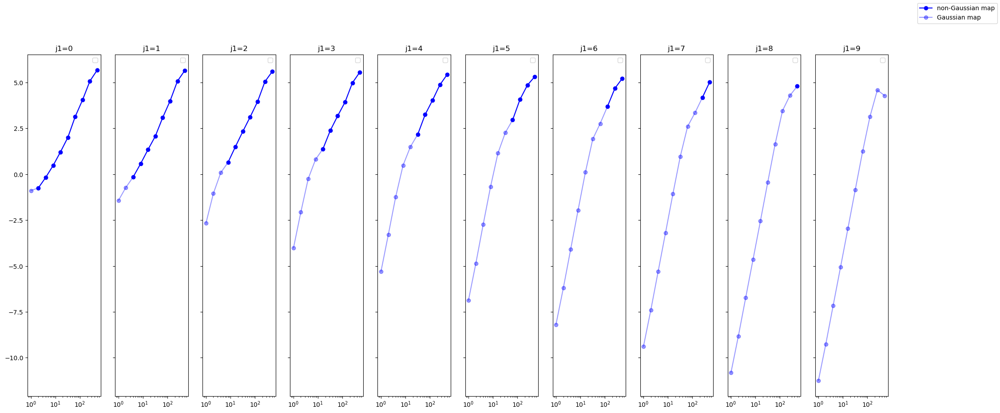

In [122]:
fig, ax = plt.subplots(1, jmax,sharey=True,squeeze=True,figsize=(25,10))
for j in range (jmax):
    ax[j].plot (scale[j+1:],np.log(s2[j,j+1:]/s1[j]),'o-' , alpha =1 , color = "blue")
    #ax[j].plot (scale_0256[j+1:],np.log(s2_cubed_Gaus_0256[j,j+1:]),'o-' , alpha = 1 , color = "red")
    ax[j].plot (scale,np.log(s2[j,:]/s1[j]),'o-' , alpha = 0.4 , color = "blue")
    #ax[j].plot (scale_0256,np.log(s2_cubed_Gaus_0256[j,:]),'o-' , alpha =0.4 , color = "red")
    ax[j].set_title("j1=%d"%j)
    ax[j].set_xscale('log')
    ax[j].legend()
fig.legend(['non-Gaussian map' ,'Gaussian map'])

# Energy Conservation Equiation

normalizing scattering coefficients:   $S_{0}\left(j_{}, \theta_{1}\right)=\frac{1}{\mu_{0}} \int I (\boldsymbol{x}) \mathrm{d}^{2} \boldsymbol{x}$

$S_{1}\left(j_{1}, \theta_{1}\right)=\frac{1}{\mu_{1}} \int\left|I \star \psi_{j_{1}, \theta_{1}}\right|(\boldsymbol{x}) \mathrm{d}^{2} \boldsymbol{x}$

$S_{2}\left(j_{1}, \theta_{1}, j_{2}, \theta_{2}\right)=\frac{1}{\mu_{2}} \int\left| \left | I \star \psi_{j_{1}, \theta_{1}}\right|\star \psi_{j_{2}, \theta_{2}}\right|(\boldsymbol{x}) \mathrm{d}^{2} \boldsymbol{x}$

total energy of the field : $||I_0||^2 = \frac{1}{\mu_{0}} \int\left|I \right|(\boldsymbol{x}) \mathrm{d}^{2} \boldsymbol{x}$

Energy conservation:  $||I_0||^2 = S0^2 + \sum S1^2 + \sum S_2^2$

In [40]:
m0 = x_dim* y_dim

In [123]:
map_delta = np.zeros((x_dim, y_dim))
map_delta[int(x_dim/2+1),int(y_dim/2+1)] = 1

In [124]:
s1_delta , i1_delta = comp_s1(map_delta, morlet_arr, jmax)
s2_delta , i2_delta = comp_s2(i1_delta, morlet_arr, jmax)

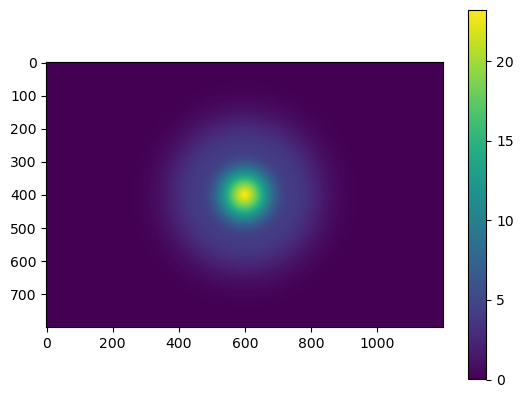

In [135]:
plt.imshow(np.abs(np.abs(morlet_arr[7])))
plt.colorbar()

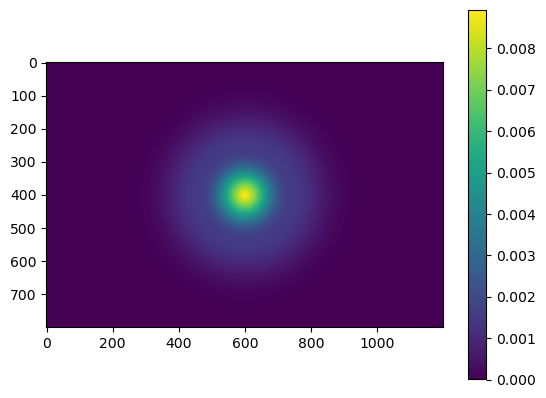

In [126]:
plt.imshow (i1_delta[7])
plt.colorbar()

In [144]:
np.mean(np.abs(morlet_arr[8]))

1.0416666735779086e-06

In [53]:
np.mean(np.abs(i1_delta[2]))

8.69244766958387e-07

In [32]:
np.sum(i1_delta[2]-np.abs (np.abs(morlet_arr[2])))

2.3732098684646957e-14

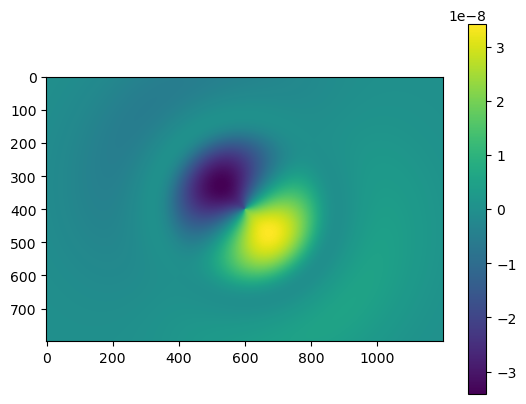

In [52]:
plt.imshow(i1_delta[8]-np.abs (np.abs(morlet_arr[8])))
plt.colorbar()

In [62]:
s1_normalized = s1/s1_delta
s2_normalized = s2/s2_delta

In [60]:
s1_delta

array([9.44521664e-07, 8.77335225e-07, 8.69244767e-07, 8.68327157e-07,
       8.68213873e-07, 8.68199736e-07, 8.68197990e-07, 8.68138914e-07,
       7.78147976e-07, 3.27272290e-07])

In [64]:
s1_normalized/mu0


array([4.38249798e-07, 7.69496953e-07, 1.21293186e-06, 2.09851400e-06,
       3.27908529e-06, 5.36165876e-06, 8.58984880e-06, 1.05754637e-05,
       1.46022918e-05, 1.81596457e-05])

In [127]:
I0sqrt = np.mean(img**2)
I0sqrt

5.37091587241844e-08

In [137]:
s1

array([ 0.42072085,  0.73871624,  1.1644148 ,  2.01457378,  3.14792166,
        5.14719268,  8.24625304, 10.1524473 , 14.01820025, 17.43325912])

In [61]:
s1_normalized**2

array([1.92063826e-13, 5.92124403e-13, 1.47120442e-12, 4.40376187e-12,
       1.07524000e-11, 2.87473847e-11, 7.37855028e-11, 1.11840433e-10,
       2.13226927e-10, 3.29772732e-10])

In [62]:
s0_normalized = np.mean(np.abs(img))
s0_normalized**2 

4.930244921324824e-08

In [145]:
s1


array([4.38250884e-07, 7.69496082e-07, 1.21293208e-06, 2.09851436e-06,
       3.27908506e-06, 5.36165905e-06, 8.58984691e-06, 1.05754659e-05,
       1.46022919e-05, 1.81596449e-05])

In [40]:
s2_sum = 0 
for j1 in range (jmax):
    for j2 in range (j1+1 , jmax):
        s2_sum += s2[j1,j2]**2

In [41]:
I0sqrt-s0**2

4.406709510936161e-09

In [42]:
np.sum(s1**2)

7.747845238419917e-10

In [43]:
RHS = s0_normalized**2 + np.sum(s1**2) + s2_sum #+s3_sum

In [44]:
(I0sqrt-RHS)/I0sqrt


0.06720986995960537

In [45]:
(I0sqrt-s0_normalized**2)/I0sqrt

0.08204763611297988

In [46]:
s3 = comp_s3(i2, morlet_arr, jmax)

In [47]:
s3_delta = comp_s3(i2_delta, morlet_arr, jmax)

In [48]:
s3_normalized = s3/s3_delta 

<ipython-input-48-ee35e1ebd7a6>:1: RuntimeWarning: invalid value encountered in true_divide
  s3_normalized = s3/s3_delta


In [49]:
s3_sum = 0
for j1 in range (jmax):
    for j2 in range (j1+1, jmax):
        for j3 in range (j2+1, jmax):
            s3_sum += s3[j1,j2,j3]**2

In [50]:
s3_sum

1.4699173207103045e-13

second energy conservation equation:  $||I_1\left(j_{}, \theta_{1}\right)||^2 =   S1\left(j_{}, \theta_{1}\right)^2 + \sum S_2^2$

In [51]:
j_select = 8
I1sqrt = np.mean(i1[j_select]**2)
#I1sqrt /= s1_delta[j_select]
s3_sum1 = 0
for j2 in range (j_select+1, jmax):
    for j3 in range (j2+1, jmax):
        s3_sum1 += s3[j_select,j2,j3]**2
RHS1 = s1[j_select]**2 + np.sum(s2[j_select,j_select+1:]**2) +s3_sum1 
(I1sqrt - RHS1)/I1sqrt

0.24664591313315298

# reproducing the input field

In [70]:
img.shape

(800, 1200)

In [68]:
cat_k , cat_Pk = fourier_power_spectrum (img , 1024 , 64 )

IndexError: boolean index did not match indexed array along dimension 1; dimension is 601 but corresponding boolean dimension is 401

In [ ]:
C_w = (s*np.pi)**2 *(np.abs(mor_fft)**2/)

# Arbitrary Gaussian map

In [71]:
N = 10 
pix_num = 2**N
pix_size  = 0.5 # size of a pixel in arcminutes

<ipython-input-72-015c0e24dca1>:6: RuntimeWarning: divide by zero encountered in true_divide
  ellsc=21600/ell # scale = 360/ell (deg) = 21600/ell (arcmin)
<ipython-input-72-015c0e24dca1>:10: RuntimeWarning: divide by zero encountered in true_divide
  plt.plot (ell, np.log(dl/(ell*(ell+1))))


Text(0, 0.5, '$ln(D_l)$')

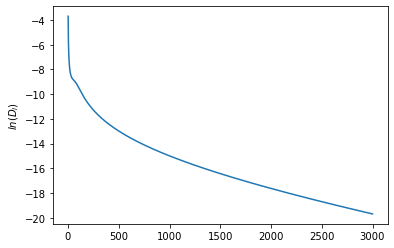

In [72]:
lmax=3000
ell=np.arange(0,lmax+1)

dl=1/(np.exp((60-ell)/20)+np.exp((ell-60)/800))

ellsc=21600/ell # scale = 360/ell (deg) = 21600/ell (arcmin)
#ellsc=ellsc[::-1]

#fdl=dl[::-1]
plt.plot (ell, np.log(dl/(ell*(ell+1))))
#plt.plot(ellsc,np.log(dl))
#plt.xlabel('scale [arcmin]')
#plt.xscale('log')
plt.ylabel('$ln(D_l)$')

In [73]:

X_width = pix_num*pix_size/60.  # horizontal map width in degrees
Y_width = pix_num*pix_size/60.  # vertical map width in degrees

In [74]:



seed = 589
np.random.seed(seed)

def make_map(pix_num, pix_size, ell, Dl): 
    "the pixel size (pix_size) required and the number N of pixels in the linear dimension."
    # convert Dl to Cl
    Cl = Dl * 2 * np.pi / (ell*(ell+1.))
    Cl[0] = 0. 
    Cl[1] = 0.

    # make a 2D real space coordinate system
    onesvec = np.ones(pix_num)
    inds  = (np.arange(pix_num)+.5 - pix_num/2.) /(pix_num-1.) # create an array of size N between -0.5 and +0.5
    # compute the outer product matrix: X[i, j] = onesvec[i] * inds[j] for i,j 
    # in range(N), which is just N rows copies of inds - for the x dimension
    X = np.outer(onesvec,inds) 
    # compute the transpose for the y dimension
    Y = np.transpose(X)
    # radial component R
    R = np.sqrt(X**2. + Y**2.)
    # now make a 2D CMB power spectrum
    pix_to_rad = (pix_size/60. * np.pi/180.) # going from pix_size in arcmins to degrees and then degrees to radians
    ell_scale_factor = 2. * np.pi /pix_to_rad  # now relating the angular size in radians to multipoles
    ell2d = R * ell_scale_factor # making a fourier space analogue to the real space R vector
    Cl_expanded = np.zeros(int(ell2d.max())+1)
    
    # making an expanded Cl spectrum (of zeros) that goes all the way to the size of the 2D ell vector
    Cl_expanded[0:(Cl.size)] = Cl # fill in the Cls until the max of the Cl vector

    # the 2D Cl spectrum is defined on the multiple vector set by the pixel scale
    CL2d = Cl_expanded[ell2d.astype(int)]         
    
    # now make a realization of the given power spectrum in real space
    random_array = np.random.normal(0,1,(pix_num, pix_num))
    FT_random_array = np.fft.fft2(random_array) # take FFT since we are in Fourier space 
    
    FT_2d = np.sqrt(CL2d) * FT_random_array
    # plt.imshow(np.real(FT_2d))
    
    # move back from ell space to real space
    map_ = np.fft.ifft2(np.fft.fftshift(FT_2d)) 
    # move back to pixel space for the map
    map_ = map_/(pix_size /60.* np.pi/180.)
    # we only want to plot the real component
    map_ = np.real(map_)

    ## return the map
    return(map_)
  ###############################

def Plot_Map(Map_to_Plot, X_width, Y_width):
    from mpl_toolkits.axes_grid1 import make_axes_locatable
    print("map mean:",np.mean(Map_to_Plot),"map rms:",np.std(Map_to_Plot))
    plt.gcf().set_size_inches(5, 5)
    im = plt.imshow(Map_to_Plot, interpolation=None, origin='lower',cmap=cm.YlOrBr)
    ax=plt.gca()
    divider = make_axes_locatable(ax)
    cax = divider.append_axes("right", size="5%", pad=0.05)

    cbar = plt.colorbar(im, cax=cax)
    #cbar = plt.colorbar()
    im.set_extent([0,X_width,0,Y_width])
#     plt.ylabel('angle $[^\circ]$')
#     plt.xlabel('angle $[^\circ]$')
    
#     plt.savefig('cmbmap1.png',transparent=False)
    plt.show()
    
    return(0)
  ###############################

In [75]:



seed = 589
np.random.seed(seed)

def fourier_make_map(pix_num, k_arr, Pk): 
    "the pixel size (pix_size) required and the number N of pixels in the linear dimension."
    # convert Dl to Cl
    Cl = Pk

    # make a 2D real space coordinate system
    onesvec = np.ones(pix_num)
    inds  = (np.arange(pix_num)+.5 - pix_num/2.)  # create an array of size N between -0.5 and +0.5
    # compute the outer product matrix: X[i, j] = onesvec[i] * inds[j] for i,j 
    # in range(N), which is just N rows copies of inds - for the x dimension
    X = np.outer(onesvec,inds) 
    #print (X)
    # compute the transpose for the y dimension
    Y = np.transpose(X)
    #print (Y)
    # radial component R
    R = np.sqrt(X**2. + Y**2.)
    
    print (R)
    # now make a 2D CMB power spectrum
    pix_to_rad = 1 #(pix_size/60. * np.pi/180.) # going from pix_size in arcmins to degrees and then degrees to radians
    ell_scale_factor = 1 /pix_to_rad  # now relating the angular size in radians to multipoles
    ell2d = R * ell_scale_factor # making a fourier space analogue to the real space R vector
    Cl_expanded = np.zeros(int(ell2d.max())+1)
    
    # making an expanded Cl spectrum (of zeros) that goes all the way to the size of the 2D ell vector
    Cl_expanded[0:(Cl.size)] = Cl # fill in the Cls until the max of the Cl vector
    print (Cl_expanded)
    # the 2D Cl spectrum is defined on the multiple vector set by the pixel scale
    CL2d = Cl_expanded[ell2d.astype(int)]         
    
    # now make a realization of the given power spectrum in real space
    random_array = np.random.normal(0,1,(pix_num, pix_num))
    FT_random_array = np.fft.fft2(random_array) # take FFT since we are in Fourier space 
    
    FT_2d = np.sqrt(CL2d) * FT_random_array
    # plt.imshow(np.real(FT_2d))
    
    # move back from ell space to real space
    map_ = np.fft.ifft2(np.fft.fftshift(FT_2d)) 
    # move back to pixel space for the map
    #map_ = map_/(pix_size /60.* np.pi/180.)
    # we only want to plot the real component
    map_ = np.real(map_)

    ## return the map
    return(map_)
  ###############################

def Plot_Map(Map_to_Plot, X_width, Y_width):
    from mpl_toolkits.axes_grid1 import make_axes_locatable
    print("map mean:",np.mean(Map_to_Plot),"map rms:",np.std(Map_to_Plot))
    plt.gcf().set_size_inches(5, 5)
    im = plt.imshow(Map_to_Plot, interpolation=None, origin='lower',cmap=cm.YlOrBr)
    ax=plt.gca()
    divider = make_axes_locatable(ax)
    cax = divider.append_axes("right", size="5%", pad=0.05)

    cbar = plt.colorbar(im, cax=cax)
    #cbar = plt.colorbar()
    im.set_extent([0,X_width,0,Y_width])
#     plt.ylabel('angle $[^\circ]$')
#     plt.xlabel('angle $[^\circ]$')
    
#     plt.savefig('cmbmap1.png',transparent=False)
    plt.show()
    
    return(0)
  ###############################

In [76]:

if max(ell)< lmax: 
        print('WARNING: Your theory curves end before the binned ell_max')

def calculate_2d_spectrum(Map1,Map2,delta_ell,ell_max,pix_size,N):
    "calcualtes the power spectrum of a 2d map by FFTing, squaring, and azimuthally averaging"
    N=int(N)
    # make a 2d ell coordinate system
    ones = np.ones(N)
    inds  = (np.arange(N)+.5 - N/2.) /(N-1.)
    kX = np.outer(ones,inds) / (pix_size/60. * np.pi/180.)
    kY = np.transpose(kX)
    K = np.sqrt(kX**2. + kY**2.)
    ell_scale_factor = 2. * np.pi 
    ell2d = K * ell_scale_factor
    
    # make an array to hold the power spectrum results
    N_bins = int(ell_max/delta_ell)
    ell_array = np.arange(N_bins)
    CL_array = np.zeros(N_bins)
    
    # get the 2d fourier transform of the map
    FMap1 = np.fft.ifft2(np.fft.fftshift(Map1))
    FMap2 = np.fft.ifft2(np.fft.fftshift(Map2))
    PSMap = np.fft.fftshift(np.real(np.conj(FMap1) * FMap2))
    # fill out the spectra
    i = 0
    while (i < N_bins):
        ell_array[i] = (i + 0.5) * delta_ell
        inds_in_bin = ((ell2d >= (i* delta_ell)) * (ell2d < ((i+1)* delta_ell))).nonzero()
        CL_array[i] = np.mean(PSMap[inds_in_bin])
        #print i, ell_array[i], inds_in_bin, CL_array[i]
        i = i + 1
 
    # return the power spectrum and ell bins
    return(ell_array,CL_array*np.sqrt(pix_size /60.* np.pi/180.)*2.)




<ipython-input-74-ee9eb21f0b5d>:7: RuntimeWarning: divide by zero encountered in true_divide
  Cl = Dl * 2 * np.pi / (ell*(ell+1.))


map mean: -0.28129210717496145 map rms: 1.6804419438906286


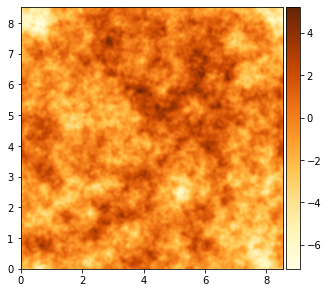

0

In [77]:
fmap = make_map(pix_num ,pix_size, ell, dl)
Plot_Map(fmap ,X_width, Y_width)

map mean: 2.9030103763458444 map rms: 4.566902997368108


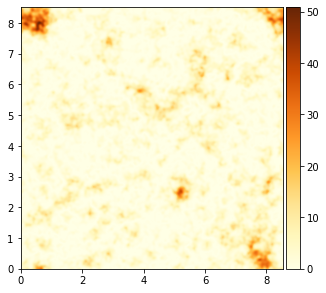

0

In [78]:
fmap_sqrt = fmap**2
Plot_Map(fmap_sqrt, X_width, Y_width)

[5.000e-01 1.500e+00 2.500e+00 3.500e+00 4.500e+00 5.500e+00 6.500e+00
 7.500e+00 8.500e+00 9.500e+00 1.050e+01 1.150e+01 1.250e+01 1.350e+01
 1.450e+01 1.550e+01 1.650e+01 1.750e+01 1.850e+01 1.950e+01 2.050e+01
 2.150e+01 2.250e+01 2.350e+01 2.450e+01 2.550e+01 2.650e+01 2.750e+01
 2.850e+01 2.950e+01 3.050e+01 3.150e+01 3.250e+01 3.350e+01 3.450e+01
 3.550e+01 3.650e+01 3.750e+01 3.850e+01 3.950e+01 4.050e+01 4.150e+01
 4.250e+01 4.350e+01 4.450e+01 4.550e+01 4.650e+01 4.750e+01 4.850e+01
 4.950e+01 5.050e+01 5.150e+01 5.250e+01 5.350e+01 5.450e+01 5.550e+01
 5.650e+01 5.750e+01 5.850e+01 5.950e+01 6.050e+01 6.150e+01 6.250e+01
 6.350e+01 6.450e+01 6.550e+01 6.650e+01 6.750e+01 6.850e+01 6.950e+01
 7.050e+01 7.150e+01 7.250e+01 7.350e+01 7.450e+01 7.550e+01 7.650e+01
 7.750e+01 7.850e+01 7.950e+01 8.050e+01 8.150e+01 8.250e+01 8.350e+01
 8.450e+01 8.550e+01 8.650e+01 8.750e+01 8.850e+01 8.950e+01 9.050e+01
 9.150e+01 9.250e+01 9.350e+01 9.450e+01 9.550e+01 9.650e+01 9.750e+01
 9.850

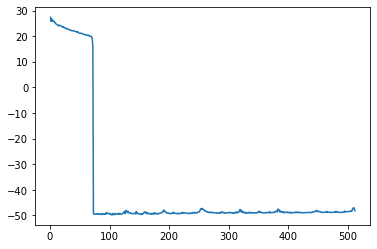

In [79]:
fmap_k , fmap_power = calculate_power(fmap)
plt.plot(fmap_k, np.log(fmap_power))

/Users/arefe/opt/anaconda3/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3474: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/Users/arefe/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


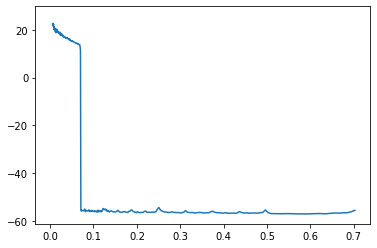

In [80]:
fmap_k , fmap_power = fourier_power_spectrum(fmap, fmap.shape[0], 512)
plt.plot(fmap_k, np.log(fmap_power))

[5.000e-01 1.500e+00 2.500e+00 3.500e+00 4.500e+00 5.500e+00 6.500e+00
 7.500e+00 8.500e+00 9.500e+00 1.050e+01 1.150e+01 1.250e+01 1.350e+01
 1.450e+01 1.550e+01 1.650e+01 1.750e+01 1.850e+01 1.950e+01 2.050e+01
 2.150e+01 2.250e+01 2.350e+01 2.450e+01 2.550e+01 2.650e+01 2.750e+01
 2.850e+01 2.950e+01 3.050e+01 3.150e+01 3.250e+01 3.350e+01 3.450e+01
 3.550e+01 3.650e+01 3.750e+01 3.850e+01 3.950e+01 4.050e+01 4.150e+01
 4.250e+01 4.350e+01 4.450e+01 4.550e+01 4.650e+01 4.750e+01 4.850e+01
 4.950e+01 5.050e+01 5.150e+01 5.250e+01 5.350e+01 5.450e+01 5.550e+01
 5.650e+01 5.750e+01 5.850e+01 5.950e+01 6.050e+01 6.150e+01 6.250e+01
 6.350e+01 6.450e+01 6.550e+01 6.650e+01 6.750e+01 6.850e+01 6.950e+01
 7.050e+01 7.150e+01 7.250e+01 7.350e+01 7.450e+01 7.550e+01 7.650e+01
 7.750e+01 7.850e+01 7.950e+01 8.050e+01 8.150e+01 8.250e+01 8.350e+01
 8.450e+01 8.550e+01 8.650e+01 8.750e+01 8.850e+01 8.950e+01 9.050e+01
 9.150e+01 9.250e+01 9.350e+01 9.450e+01 9.550e+01 9.650e+01 9.750e+01
 9.850

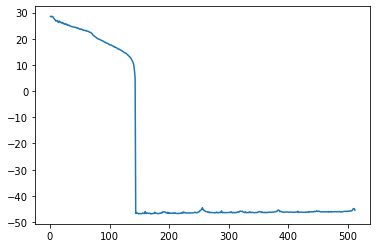

In [81]:

fmap_sqrt_k , fmap_sqrt_power = calculate_power(fmap_sqrt)

plt.plot(fmap_sqrt_k, np.log(fmap_sqrt_power))

/Users/arefe/opt/anaconda3/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3474: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/Users/arefe/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


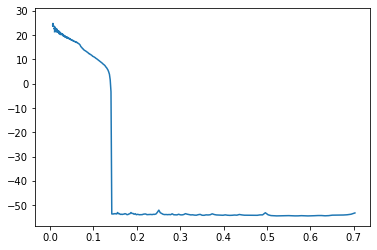

In [82]:
fmap_sqrt_k , fmap_sqrt_power = fourier_power_spectrum(fmap_sqrt, fmap_sqrt.shape[0], 512)

plt.plot(fmap_sqrt_k, np.log(fmap_sqrt_power))

In [11]:
SMALL_SIZE = 10
MEDIUM_SIZE = 15
BIGGER_SIZE = 17

plt.rc('font', size=SMALL_SIZE)          # controls default text sizes
plt.rc('axes', titlesize=MEDIUM_SIZE)     # fontsize of the axes title
plt.rc('axes', labelsize=MEDIUM_SIZE)    # fontsize of the x and y labels
plt.rc('xtick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('ytick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('legend', fontsize=SMALL_SIZE)    # legend fontsize
plt.rc('figure', titlesize=BIGGER_SIZE)  # fontsize of the figure title

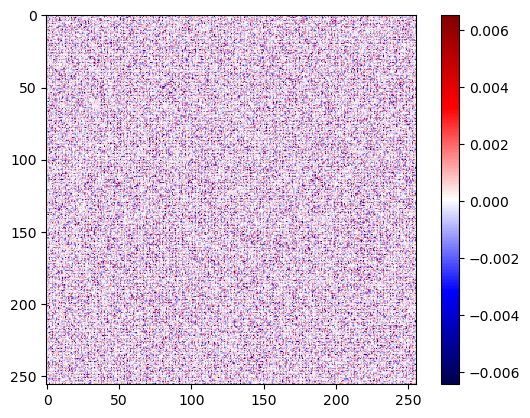

In [266]:
from FyeldGenerator import generate_field
import matplotlib.pyplot as plt
import numpy as np

# Helper that generates power-law power spectrum
def Pkgen(n):
    def Pk(k):
        return np.power(k, -n)

    return Pk

def Pksec (k):
    return ( k**2) / (1e-7 + k**4) * 2e8

# Draw samples from a normal distribution
def distrib(shape):
    a = np.random.normal(loc=0, scale=1, size=shape)
    b = np.random.normal(loc=0, scale=1, size=shape)
    return a + 1j * b


shape = (256, 256)

field = generate_field(distrib, Pkgen(-2), shape)
#field += np.abs(np.min(field))
plt.imshow(field, cmap="seismic",)
plt.colorbar()

In [267]:
field_k , field_pk = fourier_power_spectrum(field, field.shape[0],64)

/Users/arefe/.local/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3474: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/Users/arefe/.local/lib/python3.8/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Text(0, 0.5, 'P(k)')

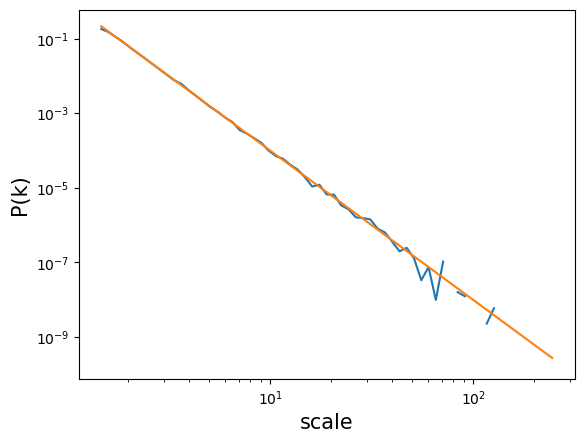

In [269]:
plt.loglog(1/field_k, field_pk*field_k**2)
plt.loglog(1/field_k, Pkgen(-2)(field_k)*field_k**2)
plt.xlabel("scale")
plt.ylabel("P(k)")

In [270]:
jmax = 7
morlet_arr = []
for j in range (jmax):
    sigma=0.8*2**j
    freq=(3*np.pi)/(4.*2**j)
    mor = morlet_2d (shape[0],shape[1], sigma, freq)
    morlet_arr.append(mor)
    
    

In [271]:
morlet_fft_arr = []
for j in range (jmax):
    mor_f =np.fft.fft2(np.fft.fftshift(morlet_arr[j]))
    morlet_fft_arr.append(mor_f)


In [272]:
s1_field, i1_field = comp_s1(field, morlet_arr, jmax)

In [273]:
s0_field = np.mean(field)

In [274]:
scale = 2**(np.arange(0,jmax))/0.75*2

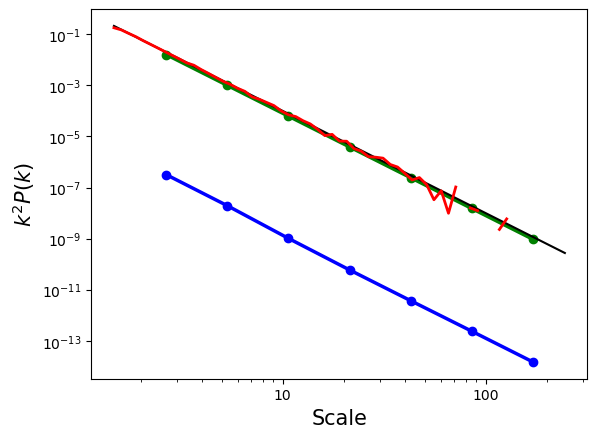

In [280]:
plt.loglog(scale,(s1_field)**2,'o-',color="blue", lw = 2.5)
plt.loglog(scale,(s1p_arr)**2,'o-',color="green", lw = 2.5)
plt.loglog(1/field_k, Pkgen(-2)(field_k)*field_k**2, color= "black", lw=1.5)
plt.loglog(1/field_k, field_pk*field_k**2, color = "red" , lw =2)
plt.xticks ([10, 100],[10, 100])
plt.xlabel("Scale")
plt.ylabel (r"$k^2 P(k)$")
#plt.legend ([r"$D_\ell$", r"$S_1^2$" ])
plt.savefig("flat.pdf",bbox_inches = 'tight', pad_inches=0.1)

In [279]:
s1p_arr = np.zeros(jmax)
for j in range(jmax):
    sigma=0.8*2**j
    freq=(3*np.pi)/(4.*2**j)
    s1p_arr[j] = (freq**1)/(sigma)/np.pi**(11/4)

In [90]:
s2_field , i2_field = comp_s2(i1_field, morlet_arr, jmax)

In [91]:
I0sqrt_field = np.mean (field**2)

In [92]:
(I0sqrt_field-s0_field**2)/I0sqrt_field

0.03782919176176384

In [93]:
(I0sqrt_field-(s0_field**2+sum(s1_field**2)))/I0sqrt_field

0.032331213135497285

In [94]:
sum(s1_field**2)/(I0sqrt_field-s0_field**2)

0.1453369308255663

In [95]:
s2_field_sum = 0 
for j1 in range (jmax):
    for j2 in range (j1+1 , jmax):
        s2_field_sum += s2_field[j1,j2]**2

In [96]:
s2_field_sum/(I0sqrt_field-s0_field**2)

0.001125666944177926

In [97]:
(I0sqrt_field-(s0_field**2+sum(s1_field**2)+s2_sum))/I0sqrt_field

0.03233077390666403

In [98]:
s3_field = comp_s3(i2_field, morlet_arr, jmax)

In [99]:
s3_field_sum = 0
for j1 in range (jmax):
    for j2 in range (j1+1, jmax):
        for j3 in range (j2+1, jmax):
            s3_field_sum += s3_field[j1,j2,j3]**2

In [100]:
s3_field_sum/(I0sqrt_field-s0_field**2)

6.73918480811006e-06

In [501]:
jselect = 8
(s1[jselect]**2-np.sum(s2[jselect,jselect+1:])**2)/s1[jselect]**2

0.9763361249540614

In [163]:
mor_k , mor_pk = fourier_power_spectrum(morlet_arr[4], morlet_arr[4].shape[0], 512)

/Users/arefe/opt/anaconda3/lib/python3.8/site-packages/numpy/fft/_pocketfft.py:70: ComplexWarning: Casting complex values to real discards the imaginary part
  r = pfi.execute(a, is_real, is_forward, fct)
/Users/arefe/opt/anaconda3/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3474: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/Users/arefe/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


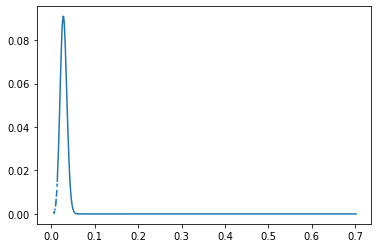

In [164]:
plt.plot(mor_k, mor_pk )

In [202]:
img_pix = morlet_arr[2].shape[0]
img_len = 1
freq = np.fft.fftfreq(n=img_pix, d=img_len) #* 2*np.pi
#rfreq = np.fft.rfftfreq(n=2*img_pix, d=img_len/img_pix) #* 2*np.pi
kx, ky = np.meshgrid(freq, freq, indexing='ij')
k_abs = np.sqrt(kx**2. + ky**2.)

In [196]:
morlet_fft = np.fft.fft2(morlet_arr[2])

In [209]:
freq

array([ 0.        ,  0.00097656,  0.00195312, ..., -0.00292969,
       -0.00195312, -0.00097656])

In [204]:
C_w   = (2*np.pi)**2 *np.nansum((np.abs(morlet_fft[])**2/k_abs**2))

<ipython-input-204-fb81894b3993>:1: RuntimeWarning: divide by zero encountered in true_divide
  C_w   = (2*np.pi)**2 *np.nansum((np.abs(morlet_fft)**2/k_abs**2))


In [205]:
np.sum (morlet_arr*np.log(2)*S)

inf

In [148]:
mor_pk


array([8.50009166e-11,            nan,            nan,            nan,
                  nan,            nan,            nan,            nan,
                  nan,            nan,            nan,            nan,
                  nan,            nan,            nan,            nan,
                  nan,            nan,            nan,            nan,
                  nan,            nan,            nan,            nan,
                  nan,            nan, 3.39365721e-10,            nan,
                  nan,            nan,            nan,            nan,
                  nan,            nan,            nan,            nan,
                  nan,            nan,            nan,            nan,
                  nan,            nan,            nan,            nan,
                  nan,            nan,            nan,            nan,
                  nan,            nan,            nan,            nan,
                  nan, 1.35624723e-09,            nan,            nan,
      

In [472]:
s1_field_sqrt, i1_field_sqrt = comp_s1(field_sqrt, morlet_arr, jmax)

In [473]:
s2_field_sqrt , i2_field_sqrt = comp_s2(i1_field_sqrt, morlet_arr, jmax)

In [474]:
I0sqrt_field_sqrt = np.mean (field_sqrt**2)

In [475]:
s0_field_sqrt = np.mean(field_sqrt)

In [476]:
(I0sqrt_field_sqrt-s0_field_sqrt**2)/I0sqrt_field_sqrt

0.8890542371129765

In [477]:
(I0sqrt_field_sqrt-(s0_field_sqrt**2+sum(s1_field_sqrt**2)))/I0sqrt_field_sqrt

0.840450385052865

In [478]:
sum(s1_field_sqrt**2)/(I0sqrt_field_sqrt-s0_field_sqrt**2)

0.05466916418726345

In [479]:
s2_field_sqrt_sum = 0 
for j1 in range (jmax):
    for j2 in range (j1+1 , jmax):
        s2_field_sqrt_sum += s2_field_sqrt[j1,j2]**2

In [480]:
s2_field_sqrt_sum/(I0sqrt_field_sqrt-s0_field_sqrt**2)

0.008611456806341717

In [486]:
(I0sqrt_field_sqrt-(s0_field_sqrt**2+sum(s1_field_sqrt**2)+s2_field_sqrt_sum))/I0sqrt_field_sqrt

0.8327943328914714

In [482]:
s3_field_sqrt = comp_s3(i2_field_sqrt, morlet_arr, jmax)

In [483]:
s3_field_sqrt_sum = 0
for j1 in range (jmax):
    for j2 in range (j1+1, jmax):
        for j3 in range (j2+1, jmax):
            s3_field_sqrt_sum += s3_field_sqrt[j1,j2,j3]**2

In [487]:
(I0sqrt_field_sqrt-(s0_field_sqrt**2+sum(s1_field_sqrt**2)+s2_field_sqrt_sum+s3_field_sqrt_sum))/I0sqrt_field_sqrt

0.8321914079812915

In [488]:
s3_field_sqrt_sum/(I0sqrt_field_sqrt-s0_field_sqrt**2)

0.0006781643740181918

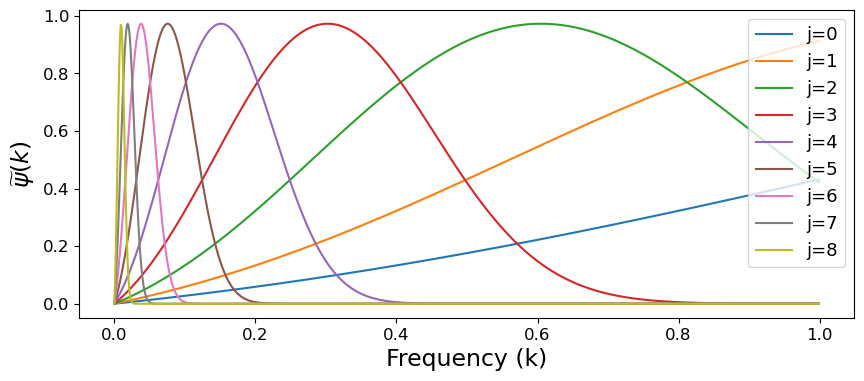

In [70]:
k = np.arange (1000)*0.001
fig=plt.figure(figsize=[10,4])
for j in range (9):
    
    sigma = 0.8*2**j
    k0 = 3*np.pi/(4*2**j)
    
    beta = np.exp (-k0**2 * sigma**2/2)
    mork = np.exp (-(k-k0)**2 * sigma**2/2) - beta * np.exp (-k**2 * sigma**2/2)
    #fig=plt.figure(figsize=[10,4])
#for j in range(jmax):
    #plt.plot(ell,np.real(morlet_l_arr_prj[j]),label='j='+str(j))
    plt.plot(k,np.real(mork),label='j='+str(j))
    plt.legend(prop={'size': 13})
    
#plt.yscale("log")
    plt.xlabel("Frequency (k)", size=17)
    plt.ylabel("$\widetilde{\psi}(k)$", size=17)
    plt.yticks(fontsize=12)
    plt.xticks(fontsize=12)
    #plt.savefig("profile2.pdf",bbox_inches = 'tight')